# Load data 



In [1]:
import pandas as pd
import numpy as np
import pylab
%matplotlib inline

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

df = pd.read_csv("../data/20181019-wikia_stats_users.csv")
df.drop_duplicates(subset=['url'], inplace=True)
df.head()

,url,creation_date,domain,founding_user_id,headline,hub,id,lang,language,name,...,topic,wam_score,stats.nonarticles,users_1,users_5,users_10,users_20,users_50,users_100,bots
0,http://spellmagotm.wikia.com,2012-05-01 13:58:13,spellmagotm.wikia.com,5069110.0,NaN,Games,529058.0,en,en,Spellmagotm Wiki,...,Gaming,0.0,221.0,5,1,1,1,1,0,5
1,http://2017-monster-energy-nascar-cup-series.w...,2017-07-24 22:35:31,2017-monster-energy-nascar-cup-series.wikia.com,32529801.0,NaN,TV,1601247.0,en,en,2017 Monster Energy NASCAR Cup Series Wiki,...,Entertainment,0.0,108.0,6,3,1,1,1,1,4
2,http://10low46japreligion.wikia.com,2009-09-15 23:21:34,10low46japreligion.wikia.com,1602876.0,NaN,Lifestyle,52061.0,en,en,Ancient Japanese Religion (Daramalan Assignmen...,...,Philosophy,0.0,239.0,7,2,1,1,1,1,5
3,http://de.bibel.wikia.com,2018-08-06 19:13:40,de.bibel.wikia.com,36490113.0,NaN,Books,1782059.0,de,de,Bibel Wiki,...,Entertainment,0.0,92.0,4,1,1,1,0,0,2
4,http://indigo-showdown.wikia.com,2014-05-30 15:43:23,indigo-showdown.wikia.com,25001469.0,NaN,Games,982346.0,en,en,Indigo showdown Wiki,...,Gaming,0.0,139.0,9,4,3,3,1,0,5


In [2]:
def describeMetric(df, metric):
    print(df[metric].describe())
    print("90%: {}".format(df[metric].quantile(0.9)))
    print("95%: {}".format(df[metric].quantile(0.95)))
    print("99%: {}".format(df[metric].quantile(0.99)))

# Content stats

- `stats.pages` refers to all pages in the wiki, including articles, talk pages, redirects, etc.
- `stats.articles` refers to the number of content pages in the wiki.

## Pages


In [3]:
describeMetric(df, 'stats.pages')

count    2.904650e+05
mean     1.025968e+03
std      2.352368e+04
min     -1.000000e+00
25%      9.800000e+01
50%      1.650000e+02
75%      2.830000e+02
max      7.727191e+06
Name: stats.pages, dtype: float64
90%: 618.0
95%: 1379.0
99%: 10277.719999999972


## Articles

In [4]:
describeMetric(df, 'stats.articles')

count    2.904650e+05
mean     1.214518e+02
std      5.644426e+03
min      0.000000e+00
25%      4.000000e+00
50%      1.000000e+01
75%      3.000000e+01
max      2.483023e+06
Name: stats.articles, dtype: float64
90%: 102.0
95%: 233.0
99%: 1301.0


# User stats

In [5]:
describeMetric(df,'users_1')

count    290465.000000
mean         26.998224
std         461.686082
min           0.000000
25%           4.000000
50%           5.000000
75%           9.000000
max      127087.000000
Name: users_1, dtype: float64
90%: 20.0
95%: 41.0
99%: 276.0


# Edit stats

In [6]:
describeMetric(df, 'stats.edits')

count    2.904650e+05
mean     2.705596e+03
std      6.892640e+04
min      0.000000e+00
25%      1.130000e+02
50%      2.410000e+02
75%      4.660000e+02
max      2.330206e+07
Name: stats.edits, dtype: float64
90%: 1451.0
95%: 3605.0
99%: 29024.239999999874


## Edits per page

In [7]:
df['editsperpage'] = df['stats.edits'] / df['stats.pages']

In [8]:
describeMetric(df, 'editsperpage')

count    2.904640e+05
mean              inf
std               NaN
min     -0.000000e+00
25%      1.088889e+00
50%      1.273913e+00
75%      1.735137e+00
max               inf
Name: editsperpage, dtype: float64
90%: 2.5463038947505536
95%: 3.348481628598769
99%: 6.420168067226891


# Distribution by language

In [9]:
groupByLanguage = df.groupby(by="lang")
byLanguage = groupByLanguage.id.count()
byLanguage.sort_values(ascending=False, inplace=True)
byLanguage

lang
en         198961
es          30374
ru          12968
de           9177
pl           7583
fr           7030
pt-br        6368
it           2706
zh           2491
nl           1280
pt           1219
ko           1144
ja           1135
tr            894
vi            774
fi            638
id            527
hu            521
cs            506
sv            487
th            389
el            355
uk            313
zh-tw         279
ro            240
he            220
da            197
no            174
ar            137
ca            127
            ...  
pie             1
ne              1
nb              1
nap             1
pms             1
prg             1
mo              1
min             1
map-bms         1
lb              1
rmy             1
ku              1
ksh             1
km              1
tt-latn         1
kl              1
sa              1
sah             1
iu              1
ia              1
ss              1
su              1
gv              1
glk             1
ga   

In [10]:
def langOther(x):
    if x in byLanguage.index[:8].values:
        return x
    else:
        return 'other'
    
byLanguage.index[:8]
df['language'] = df['lang']
df['language'] = df['language'].apply(langOther)

In [11]:
byReducedLanguage = df.groupby(by="language").id.count()
byReducedLanguage.sort_values(ascending=False, inplace=True)
byReducedLanguage

language
en       198961
es        30374
other     15298
ru        12968
de         9177
pl         7583
fr         7030
pt-br      6368
it         2706
Name: id, dtype: int64

In [12]:
values = byReducedLanguage.values
values = 100*(values/values.sum())


data = [go.Bar(
            x=values,
            y=byReducedLanguage.index.values,
            orientation = 'h'
)]

annotations = [dict(
            x=x+8,
            y=y,
            xref='x',
            yref='y',
            text='{0:.2f}%'.format(x),
            showarrow=False
        ) for (x,y) in zip(values, list(range(0,len(values))))]

layout = go.Layout(
    xaxis=dict(
        range=[0,101],
        domain=[0,0.5],
        tickfont=dict(
            size=14,
        ),
        #showline=True
    ),
    yaxis=dict(
        tickfont=dict(
            size=14,
        ),
        ticksuffix=" "
    ),
    annotations = annotations
);


iplot(go.Figure(data= data, layout=layout), filename="byLanguage")

# Distribution by hub category

Hub categories are defined by Wikia

In [13]:
groupByHub = df.groupby(by="hub")
byHub = groupByHub.id.count()
byHub.sort_values(ascending=False, inplace=True)
byHub

hub
Games        109358
Lifestyle     68398
TV            46391
Books         23492
Comics        15477
Movies        14761
Music          9261
Other          3327
Name: id, dtype: int64

In [14]:
values = byHub.values
values = 100*(values/values.sum())


data = [go.Bar(
            x=values,
            y=byHub.index.values,
            orientation = 'h'
)]

annotations = [dict(
            x=x+8,
            y=y,
            xref='x',
            yref='y',
            text='{0:.2f}%'.format(x),
            showarrow=False
        ) for (x,y) in zip(values, list(range(0,len(values))))]

layout = go.Layout(
    xaxis=dict(
        range=[0,101],
        domain=[0,0.5],
        tickfont=dict(
            size=14,
        ),
        #showline=True
    ),
    yaxis=dict(
        tickfont=dict(
            size=14,
        ),
        ticksuffix=" "
    ),
    annotations = annotations
);


iplot(go.Figure(data= data, layout=layout), filename="byHub")

# Analysis of Active and Inactive wikis

**Active wikis** are the ones with at least 1 user (`user_1`) and at least 1 active user in the previous 30 days (`stats.activeUsers`)


In [15]:
threshold = 1
totalWikis = len(df) 
deadWikis = df[(df['stats.activeUsers']<threshold)|(df['users_1']==0)]
print ("Dead Wikis: {} ({:05.2f}%)".format(len(deadWikis), 100*len(deadWikis)/totalWikis))

Dead Wikis: 227221 (78.23%)


In [16]:
aliveWikis = df[(df['stats.activeUsers']>=threshold)&(df['users_1']>0)]
print ("Alive Wikis: {} ({:05.2f}%)".format(len(aliveWikis), 100*len(aliveWikis)/totalWikis))
print("With less than 5 articles: {}".format(len(aliveWikis[aliveWikis['stats.articles']<5])))
print("With less than 24 pages: {}".format(len(aliveWikis[aliveWikis['stats.pages']<24])))
print("With less than 4 users: {}".format(len(aliveWikis[aliveWikis['users_1']<4])))

Alive Wikis: 63244 (21.77%)
With less than 5 articles: 25052
With less than 24 pages: 742
With less than 4 users: 6131


## Scatterplot of the number of users over the number of articles, distinguishing between active wikis (green) and inactive wikis (black)

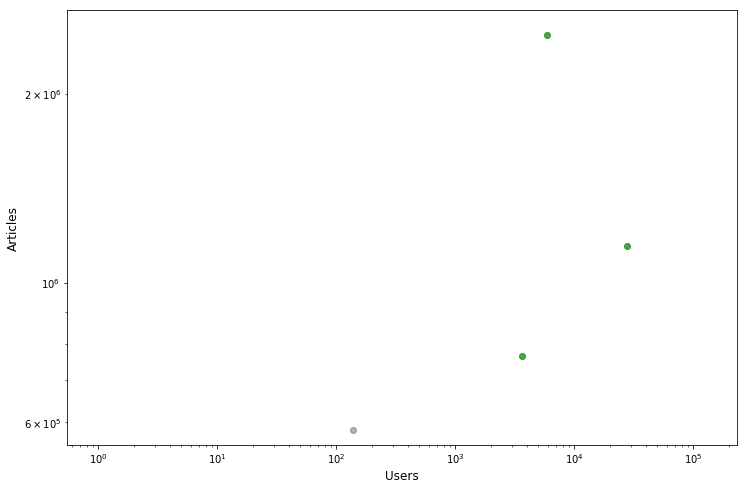

In [17]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Users', {'size': 'large'})
ax.set_ylabel('Articles', {'size': 'large'})
ax.scatter(aliveWikis['users_1'].values,aliveWikis['stats.articles'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['users_1'].values,deadWikis['stats.articles'].values, c='black', alpha=0.3)

## Scatterplot of the number of users over the number of edits, distinguishing between active wikis (green) and inactive wikis (black)


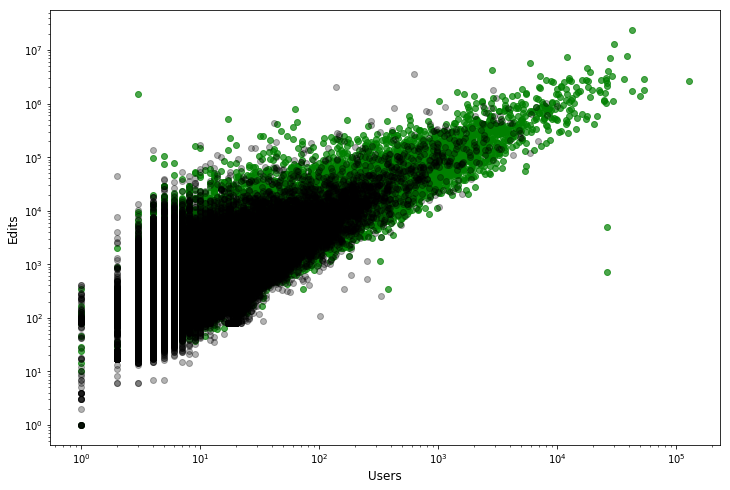

In [18]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Users', {'size': 'large'})
ax.set_ylabel('Edits', {'size': 'large'})
ax.scatter(aliveWikis['users_1'].values,aliveWikis['stats.edits'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['users_1'].values,deadWikis['stats.edits'].values, c='black', alpha=0.3)

## Scatterplot of the number of articles over the number of edits, distinguishing between active wikis (green) and inactive wikis (black)

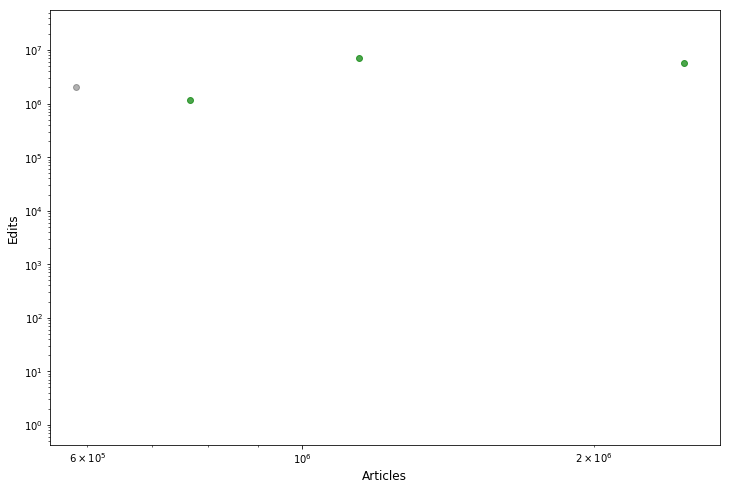

In [19]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Articles', {'size': 'large'})
ax.set_ylabel('Edits', {'size': 'large'})
ax.scatter(aliveWikis['stats.articles'].values,aliveWikis['stats.edits'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['stats.articles'].values,deadWikis['stats.edits'].values, c='black', alpha=0.3)

## Cummulative of wikis having at least U users

In [20]:
histAlive, binsAlive = np.histogram(aliveWikis[['users_1']],bins=int(aliveWikis[['users_1']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['users_1']],bins=int(deadWikis[['users_1']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [21]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        domain=[0,0.5],
        exponentformat="power",
        title="At least U users"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.3,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout))

## Cummulative of wikis having at least E edits


In [22]:
histAlive, binsAlive = np.histogram(aliveWikis[['stats.edits']],bins= 100000)#int(aliveWikis[['stats.edits']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['stats.edits']],bins=100000)#int(deadWikis[['stats.edits']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [23]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        domain=[0,0.5],
        exponentformat="power",
        title="At least E edits"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.3,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout))

## Cummulative of wikis having at least P articles

In [24]:
histAlive, binsAlive = np.histogram(aliveWikis[['stats.articles']],bins= 100000)#int(aliveWikis[['stats.articles']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['stats.articles']],bins=100000)#int(deadWikis[['stats.articles']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [25]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        domain=[0,0.5],
        exponentformat="power",
        title="At least P articles"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.3,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout), filename="edits-cumsum")